In [2]:
import tensorflow as tf
import numpy as np
import os
from PIL import Image

In [24]:
def Bilinear(orig_image, new_width, new_height):
    new_image = np.zeros((new_height, new_width, 3), dtype=np.uint8)
    for i in range(new_height):
        for j in range(new_width):
            x = j / new_width * orig_image.shape[1]
            y = i / new_height * orig_image.shape[0]
            x1 = int(x)
            y1 = int(y)
            x2 = x1 + 1
            y2 = y1 + 1
            if x2 >= orig_image.shape[1]:
                x2 = x1
            if y2 >= orig_image.shape[0]:
                y2 = y1
            dx = x - x1
            dy = y - y1
            new_image[i, j] = (1 - dx) * (1 - dy) * orig_image[y1, x1] + dx * (1 - dy) * orig_image[y1, x2] + (1 - dx) * dy * orig_image[y2, x1] + dx * dy * orig_image[y2, x2]
    return new_image


In [25]:
labels = ['OpenHand','ClosedHand']
y_train = []
x_train = []
path = "Data/PNG_A/Images"
pos = "Data/PNG_A/Positions"
res = [300, 400]
for i in os.listdir(path):
    for j in os.listdir(path + "/" + i):
        im =  Image.open(path + "/" + i + '/' + j)
        im = np.array(im)
        im = Bilinear(im, 240, 240)
        #im = im/255.0
        #im = np.expand_dims(im,axis = 2)
        x_train.append(im)
        f = open(pos + "/" + i + "/" + j.split(".")[0] + ".txt", "r")
        temp = f.read().split()
        for k in range(2):
            temp[k] = int(temp[k])/res[k]*240
        y_train.append(temp)
        f.close()

x = np.array(x_train)
y = np.array(y_train)

print(x.shape)
print(y.shape)

(1000, 240, 240, 3)
(1000, 2)


In [26]:
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(x, y, train_size=0.80, random_state=42)

In [27]:
input = tf.keras.layers.Input(shape=(240, 240, 3))
x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu')(input)/
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Flatten()(x)

x = tf.keras.layers.Dense(128, activation='relu', kernel_regularizer = tf.keras.regularizers.l1_l2(l1 = 0.01,l2 = 0.1), bias_regularizer=tf.keras.regularizers.l2(0.1))(x)
x = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer = tf.keras.regularizers.l1_l2(l1 = 0.01,l2 = 0.1), bias_regularizer=tf.keras.regularizers.l2(0.1))(x)
x = tf.keras.layers.Dense(2, kernel_regularizer = tf.keras.regularizers.l1_l2(l1 = 0.01,l2 = 0.1), bias_regularizer=tf.keras.regularizers.l2(0.1))(x)


model = tf.keras.Model(input, x)

checkpoint_filepath = "checkpoints_position/"
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True)

model.compile(optimizer='adam', loss='mse', metrics='mae')

model.fit(x_train, y_train, epochs=1000, batch_size=128, validation_data=(x_val, y_val), callbacks=[model_checkpoint_callback])

model.load_weights(checkpoint_filepath)




Epoch 1/1000


7/7 [==============================] - 9s 988ms/step - loss: 13498.5273 - mae: 96.5091 - val_loss: 4818.7007 - val_mae: 54.8992
Epoch 2/1000
7/7 [==============================] - 7s 904ms/step - loss: 4505.4604 - mae: 54.0223 - val_loss: 4162.3564 - val_mae: 52.9521
Epoch 3/1000
7/7 [==============================] - 6s 902ms/step - loss: 3364.8115 - mae: 47.5905 - val_loss: 2905.3569 - val_mae: 43.4847
Epoch 4/1000
7/7 [==============================] - 6s 905ms/step - loss: 2420.9221 - mae: 39.5620 - val_loss: 1788.5244 - val_mae: 33.1684
Epoch 5/1000
7/7 [==============================] - 6s 923ms/step - loss: 1268.0278 - mae: 26.1714 - val_loss: 939.7701 - val_mae: 21.6941
Epoch 6/1000
7/7 [==============================] - 7s 973ms/step - loss: 743.3748 - mae: 18.5075 - val_loss: 630.0454 - val_mae: 16.8333
Epoch 7/1000
7/7 [==============================] - 7s 943ms/step - loss: 561.6541 - mae: 15.4095 - val_loss: 498.0138 - val_mae: 13.9021
Epoch 8/1000
7/7 [=

In [28]:
# Execute Cell Index 3 first to define and train the model

model.evaluate(x_val, y_val)


7/7 [==============================] - 0s 54ms/step - loss: 49.0544 - mae: 2.9576


[49.054447174072266, 2.9575839042663574]

1/1 [==============================] - 0s 24ms/step


[[ 78.801765 150.92477 ]]


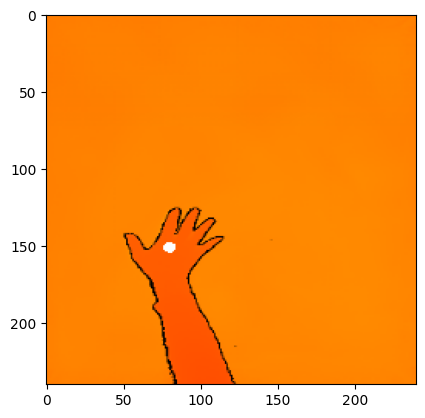

In [52]:
im = x_val[99]
predictions = model.predict(im.reshape(1, 240, 240, 3))

print(predictions)

for x in range(240):
    for y in range(240):
        if((x - predictions[0][0])**2 + (y - predictions[0][1])**2 < 10):
            im[y][x] = [255, 255, 255]

import matplotlib.pyplot as plt
plt.imshow(im)
plt.show()




In [53]:
import tf2onnx

tf2onnx.convert.from_keras(model, output_path="hand_positionV3.onnx")

(ir_version: 8
 producer_name: "tf2onnx"
 producer_version: "1.16.1 15c810"
 graph {
   node {
     input: "input_1"
     output: "model/conv2d/BiasAdd__6:0"
     name: "model/conv2d/BiasAdd__6"
     op_type: "Transpose"
     attribute {
       name: "perm"
       ints: 0
       ints: 3
       ints: 1
       ints: 2
       type: INTS
     }
   }
   node {
     input: "model/conv2d/BiasAdd__6:0"
     input: "model/conv2d/Conv2D/ReadVariableOp:0"
     input: "model/conv2d/BiasAdd/ReadVariableOp:0"
     output: "model/conv2d/BiasAdd:0"
     name: "model/conv2d/BiasAdd"
     op_type: "Conv"
     attribute {
       name: "dilations"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "strides"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "kernel_shape"
       ints: 3
       ints: 3
       type: INTS
     }
     attribute {
       name: "group"
       i: 1
       type: INT
     }
     domain: ""
   }
   node {
     inpu

[array([[ 46.820988, 207.93253 ]], dtype=float32)]


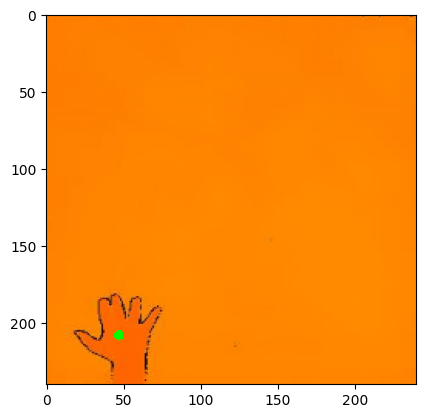

In [72]:
import onnxruntime
import matplotlib.pyplot as plt

img = Image.open("Data/JPG/Images/OpenHand/3.jpg")
#img = img.resize((240,240), Image.BILINEAR)
img = Bilinear(np.array(img), 240, 240)
img = np.array(img)


# Load the ONNX model
sess = onnxruntime.InferenceSession("hand_positionV3.onnx")
intput_name = sess.get_inputs()[0].name
output_name = sess.get_outputs()[0].name
image = img.astype(np.float32)

onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: image.reshape(1,240,240,3)})
print(onnx_predicted_label)

for x in range(240):
    for y in range(240):
        if((x - onnx_predicted_label[0][0][0])**2 + (y - onnx_predicted_label[0][0][1])**2 < 10):
            img[y][x] = [0, 255, 0]

plt.imshow(img)
plt.show()

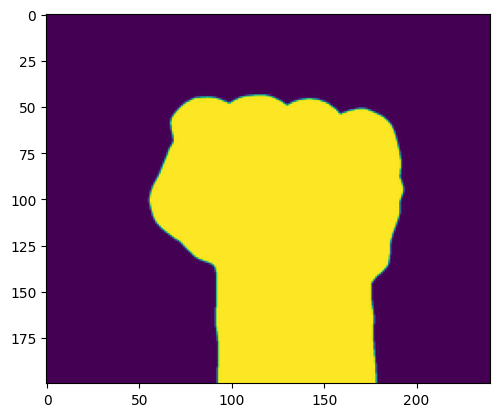

(1, 200, 240, 1)


In [41]:
img = Image.open("okay3.png")
for i in range(img.size[0]):
    for j in range(img.size[1]):
        if img.getpixel((i, j))[0] > 230 and img.getpixel((i, j))[1] > 230 and img.getpixel((i, j))[2] > 230:
            img.putpixel((i, j), (0,0,0))
        else:
            img.putpixel((i, j), (255, 255, 255))
img = img.convert('L')
img = img.resize((240, 200), Image.LANCZOS)
img = np.array(img)
plt.imshow(img)
plt.show()
img = img.reshape(1, 200, 240, 1)
print(img.shape)


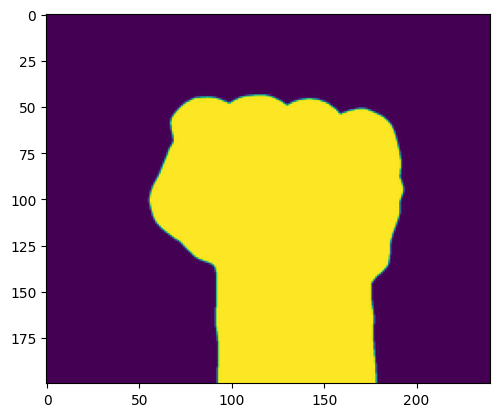

rock
[array([[3.1971749e-07, 1.3945986e-08, 9.9999964e-01]], dtype=float32)]


In [42]:
predictions = onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: img.astype(np.float32)})
plt.imshow(img.reshape(200, 240))
plt.show()
print(labels[np.argmax(predictions)])
print(predictions)

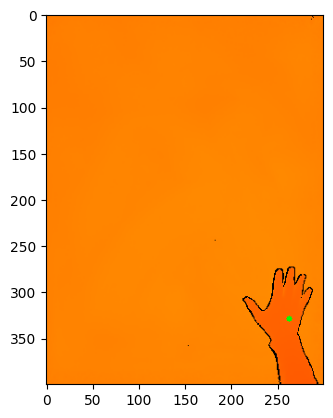

In [23]:
img = Image.open("Data/PNG_A/Images/OpenHand/55.png")
img = np.array(img)
position = open("Data/PNG_A/Positions/OpenHand/55.txt", "r").read().split()
x1 = int(position[0])
y1 = int(position[1])

for x in range(300):
    for y in range(400):
        if((x - x1)**2 + (y - y1)**2 < 10):
            img[y][x] = [0, 255, 0]

plt.imshow(img)
